The objective of this project is to do audio classification. We are going to do music genre classification. The dataset has been obtained from the following url: http://marsyas.info/downloads/datasets.html

We are going to use Google Colab for this project as it facilitates the usage of free GPU.

In [0]:
#commenting the below 2 lines as it contains information related to my Google account
#from google.colab import drive
#drive.mount('/content/drive')

In [0]:
import tarfile
import pandas as pd
import numpy as np
import os, shutil
from math import ceil, floor
from IPython.display import display, Audio
from PIL import Image
import librosa
import librosa.display
import matplotlib.pyplot as plt

In [0]:
def delete_file_directory(path, isDirectory):
  if isDirectory:
    shutil.rmtree(path)
  else:
    os.remove(path)

In [0]:
def handle_tarfile(filePath):
  
  if filePath.endswith('tar.gz'):
    tarContent = tarfile.open(filePath, "r:gz")
  else:
    tarContent = tarfile.open(filePath, "r:")

  tarContent.extractall()
  tarContent.close()

In [0]:
handle_tarfile('drive/My Drive/datasets/music_genre/genres.tar.gz')

In [6]:
os.listdir('genres')

['po.mf',
 'ja.mf',
 'di.mf',
 'hi.mf',
 'ro.mf',
 'jazz',
 'rock',
 'reggae',
 'co.mf',
 'input.mf',
 'hiphop',
 'disco',
 'metal',
 'country',
 're.mf',
 'cl.mf',
 'pop',
 'blues',
 'bl.mf',
 'me.mf',
 'bextract_single.mf',
 'classical']

In [0]:
genres_list = []
for content in os.listdir('genres'):
  if not content.endswith('.mf'):
    genres_list.append(content)

In [8]:
genres_list

['jazz',
 'rock',
 'reggae',
 'hiphop',
 'disco',
 'metal',
 'country',
 'pop',
 'blues',
 'classical']

In [9]:
len(genres_list)

10

In [10]:
for cur_genre in genres_list:
  print('number of files in the genre {}'.format(cur_genre))
  print(len(os.listdir('genres/'+cur_genre)))

number of files in the genre jazz
100
number of files in the genre rock
100
number of files in the genre reggae
100
number of files in the genre hiphop
100
number of files in the genre disco
100
number of files in the genre metal
100
number of files in the genre country
100
number of files in the genre pop
100
number of files in the genre blues
100
number of files in the genre classical
100


let us listen to one audio file from each music genre

In [11]:
for cur_genre in genres_list:
  print('current genre {}'.format(cur_genre))
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  display(Audio(base_dir+'/'+audio_file))

current genre jazz


current genre rock


current genre reggae


current genre hiphop


current genre disco


current genre metal


current genre country


current genre pop


current genre blues


current genre classical


We will using the librosa python package for audio analysis

We will take one audio file from each genre and start by plotting it's monophonic waveform

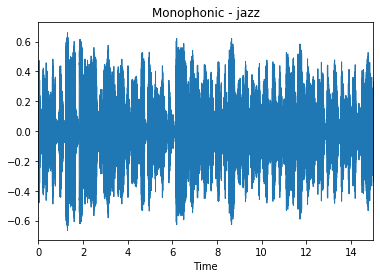

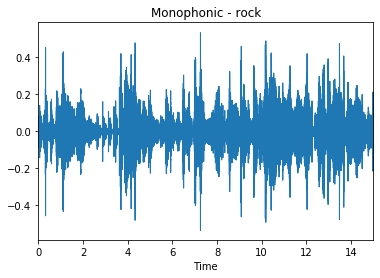

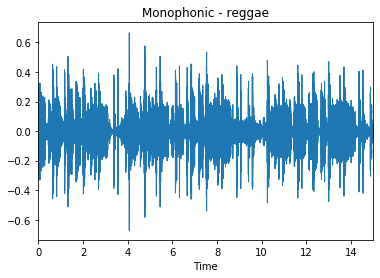

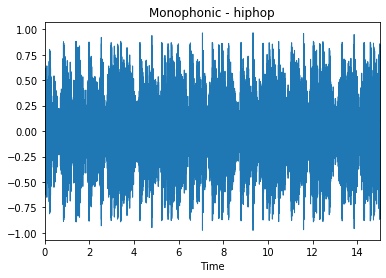

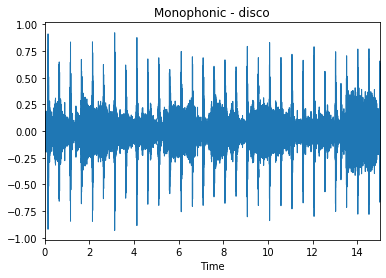

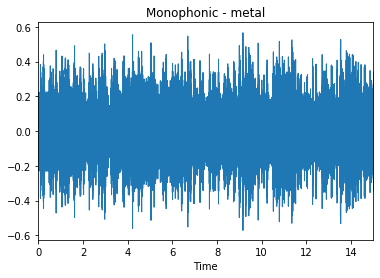

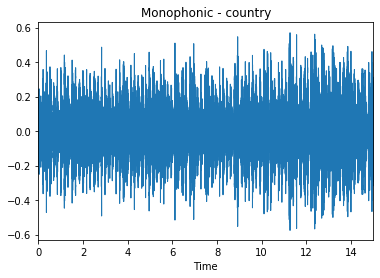

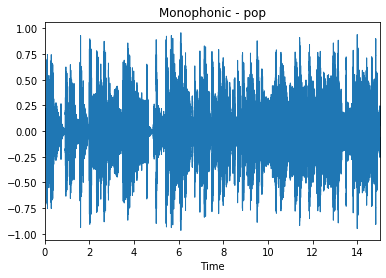

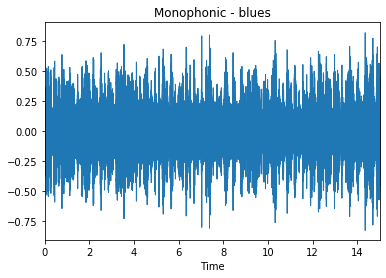

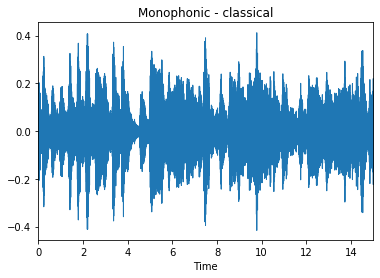

In [12]:
for cur_genre in genres_list:
  #print('current genre {}'.format(cur_genre))
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  y, sr = librosa.load(base_dir+'/'+audio_file, duration=15)
  plt.figure()
  librosa.display.waveplot(y, sr=sr)
  plt.title('Monophonic - '+cur_genre)

Now, We will take one audio file from each genre and plot the mel scaled spectrogram

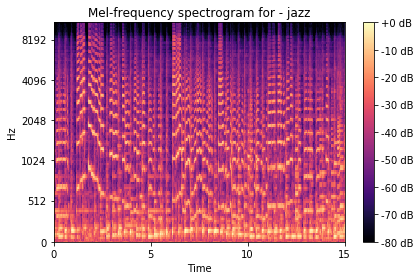

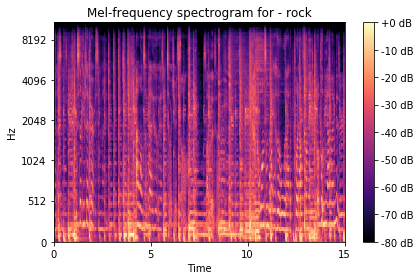

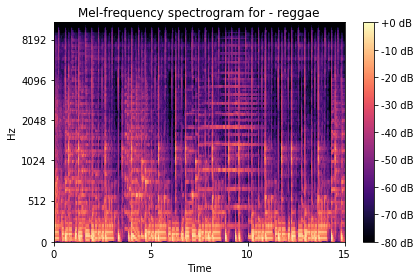

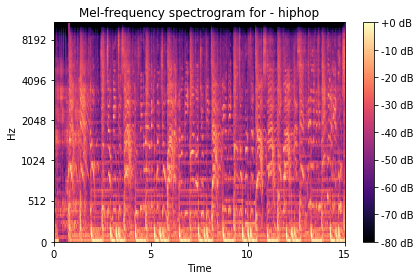

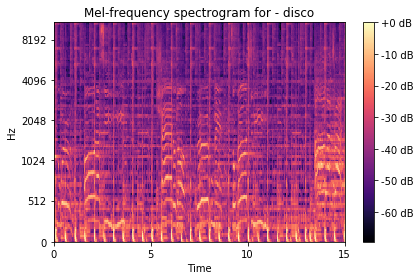

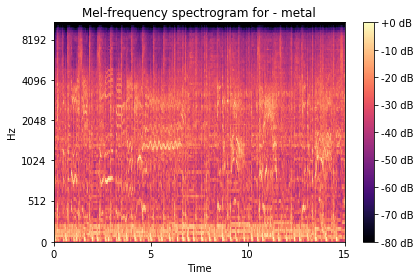

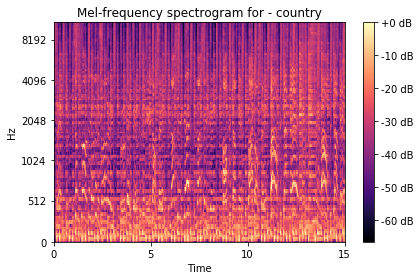

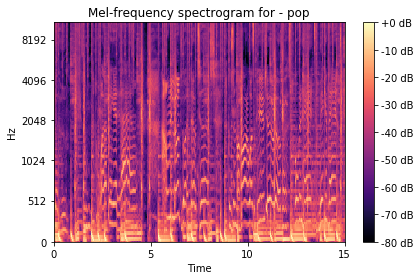

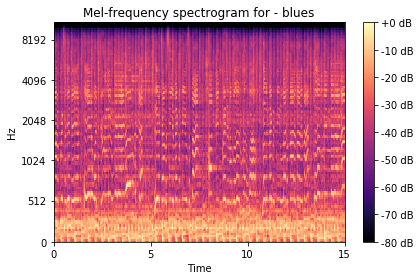

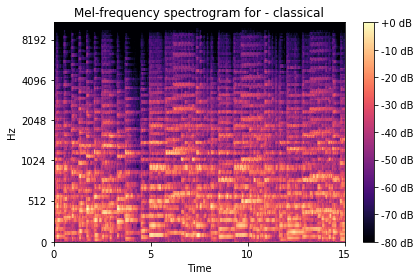

In [13]:
for cur_genre in genres_list:
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  y, sr = librosa.load(base_dir+'/'+audio_file, duration=15)
  S = librosa.feature.melspectrogram(y=y, sr=sr)
  S_dB = librosa.power_to_db(S, ref=np.max)
  plt.figure()
  librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr)
  plt.colorbar(format='%+2.0f dB')
  plt.title('Mel-frequency spectrogram for - '+cur_genre)
  plt.tight_layout()

Now, We will take one audio file from each genre and plot the Chromagram

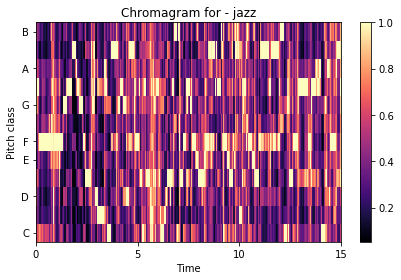

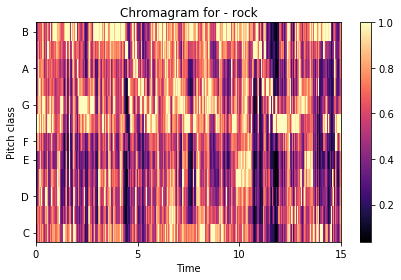

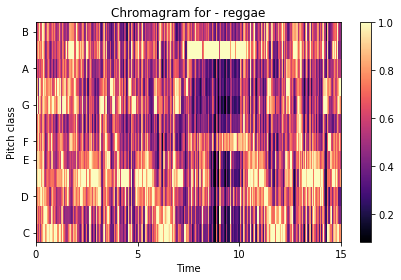

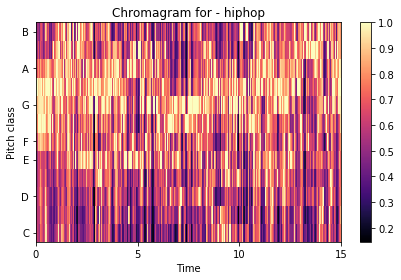

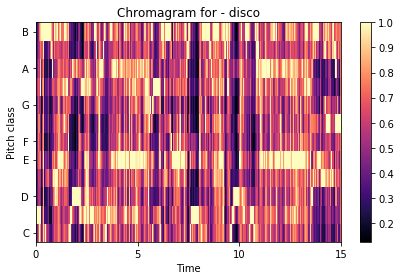

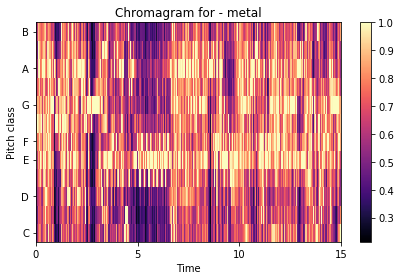

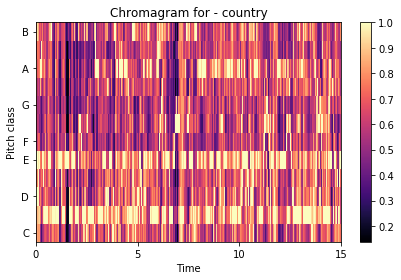

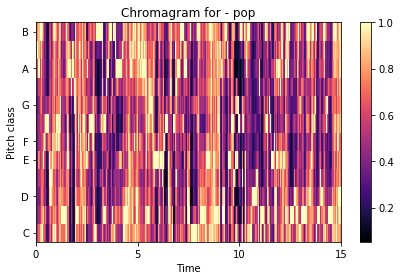

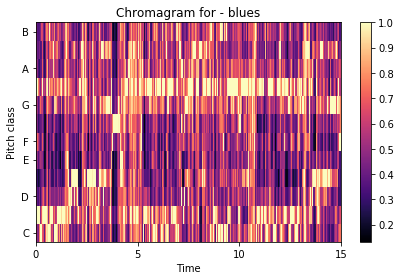

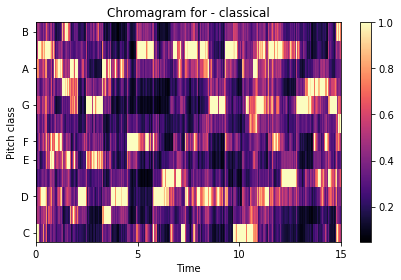

In [14]:
for cur_genre in genres_list:
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  y, sr = librosa.load(base_dir+'/'+audio_file, duration=15)
  S = np.abs(librosa.stft(y))
  chroma = librosa.feature.chroma_stft(S=S, sr=sr)
  plt.figure()
  librosa.display.specshow(chroma, x_axis='time', y_axis='chroma', sr=sr)
  plt.colorbar()
  plt.title('Chromagram for - '+cur_genre)
  plt.tight_layout()

Now we are going to generate the mel scaled spectrogram plots for all the audio files and save them as images. Then we are going to use these images for genre classification

In [0]:
os.mkdir('mel_scaled_spectrogram_imgs')

In [0]:
for cur_genre in genres_list:
  os.mkdir('mel_scaled_spectrogram_imgs/'+cur_genre)

In [0]:
def generate_mel_spectrogram_imgs():
  for cur_genre in genres_list:
    base_dir = 'genres/' + cur_genre
    audio_files = os.listdir(base_dir)
    for cur_audio_file in audio_files:
      y, sr = librosa.load(base_dir + '/' + cur_audio_file, duration=15)
      S = librosa.feature.melspectrogram(y=y, sr=sr)
      S_dB = librosa.power_to_db(S, ref=np.max)
      fig = plt.figure(figsize=(8,5))
      ax = plt.axes()
      ax.set_axis_off()
      librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr)
      img_name = cur_audio_file.split('.wav')[0] + '.png'
      img_path = 'mel_scaled_spectrogram_imgs/' + cur_genre + '/' + img_name
      plt.savefig(img_path, bbox_inches='tight', transparent=True, pad_inches=0.0 )
      plt.close(fig)


In [0]:
generate_mel_spectrogram_imgs()

In [0]:
def display_sample_imgs(path):
  for cur_genre in genres_list:
    print('current genre:', cur_genre)
    cur_genre_dir = path + cur_genre
    cur_imgs = os.listdir(cur_genre_dir)[:4]
    canvas_sheet_width = 1184
    canvas_sheet_height = 320
    canvas_sheet = Image.new('RGB', (canvas_sheet_width, canvas_sheet_height))
    x = 32
    for cur_img in cur_imgs:
      img = Image.open(cur_genre_dir + '/' + cur_img)
      img = img.resize((256,256))
      canvas_sheet.paste(img, (x, 32))
      x += 256 + 32
    display(canvas_sheet)

current genre: jazz


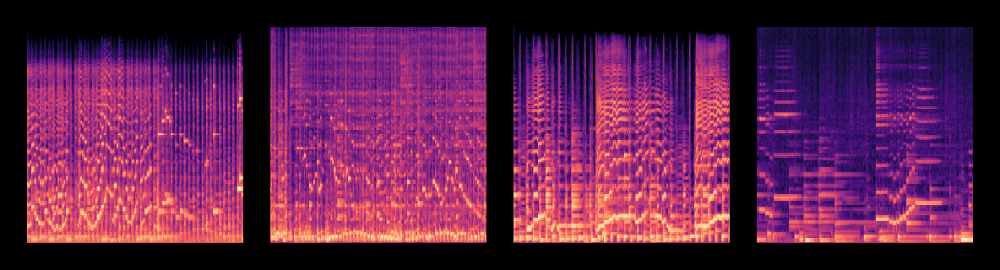

current genre: rock


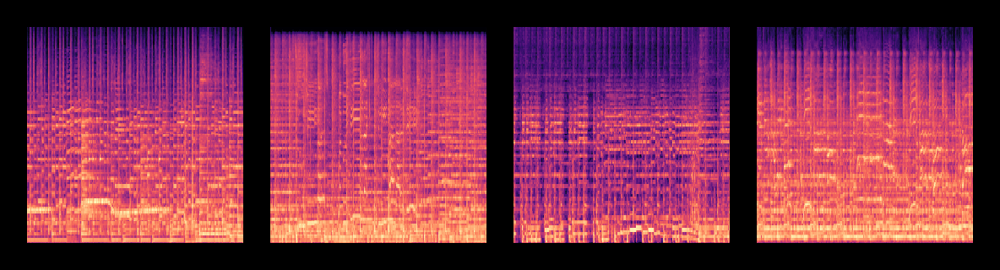

current genre: reggae


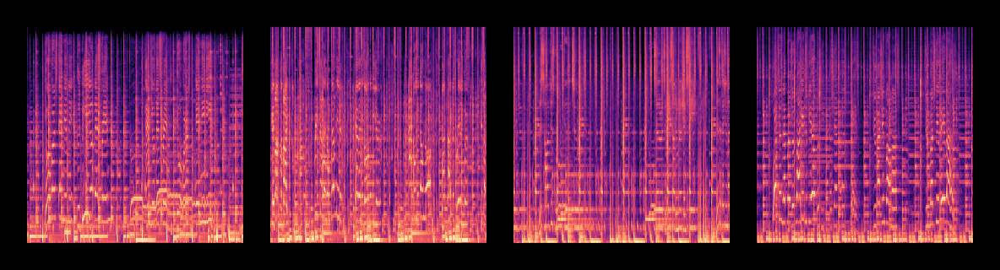

current genre: hiphop


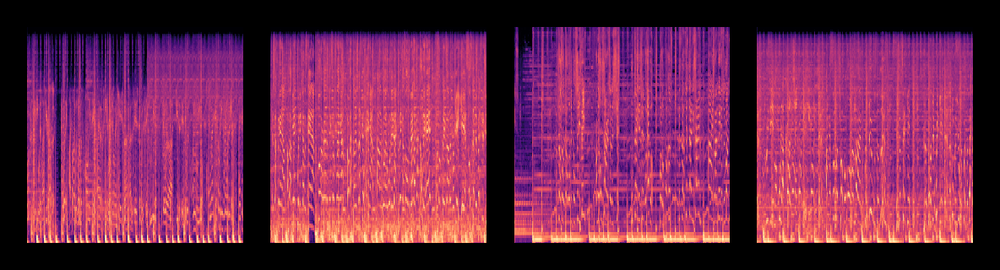

current genre: disco


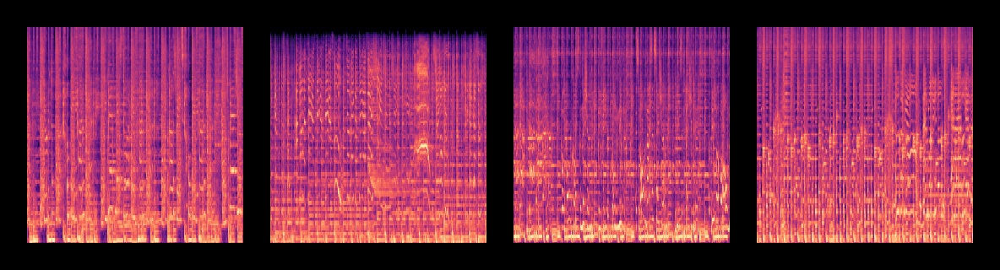

current genre: metal


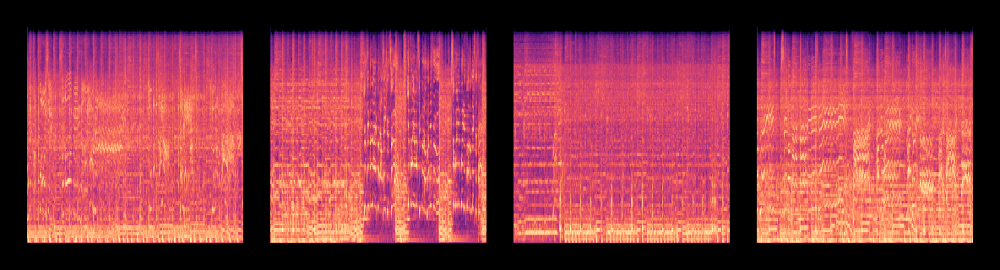

current genre: country


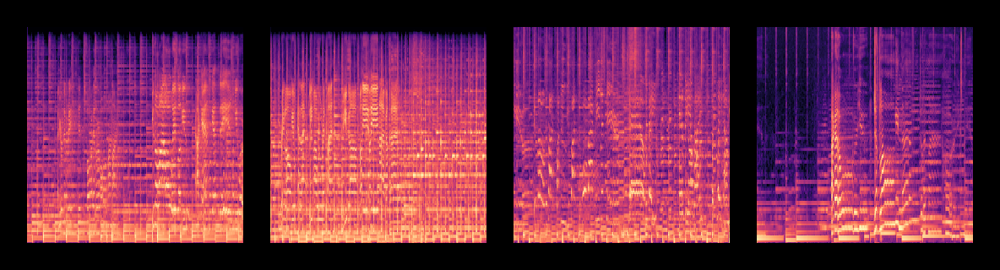

current genre: pop


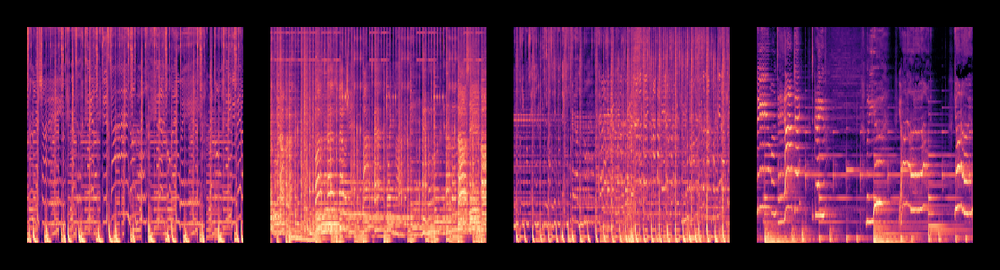

current genre: blues


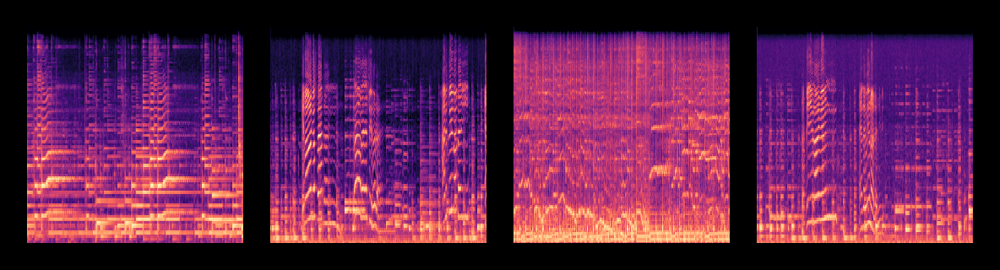

current genre: classical


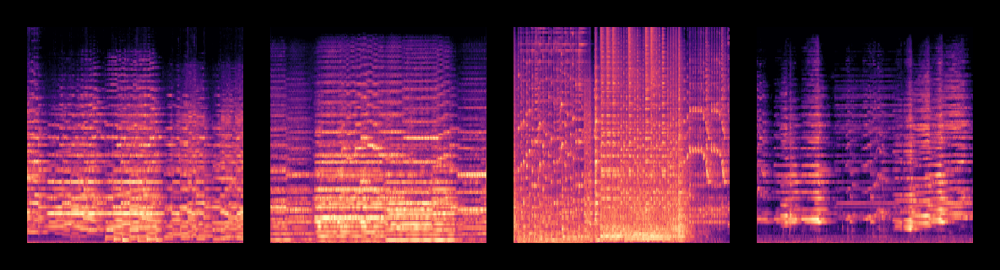

In [20]:
display_sample_imgs('mel_scaled_spectrogram_imgs/')

we are going to break the overall dataset into 3 sets. Training (70%), validation (15%) and testing (15%). In each of these folders, create folders for all the genres

In [0]:
assessment_dirs = ['TRAIN', 'TEST', 'VAL']
for cur_dir in assessment_dirs:
  os.mkdir(cur_dir)
  for cur_genre in genres_list:
    os.mkdir(cur_dir + '/' + cur_genre)

In [0]:
def move_files(base_src, base_dst, steps=1):
  for cur_genre in genres_list:
    print('current genre', cur_genre)
    cur_imgs = os.listdir(base_src + '/' + cur_genre)
    num_of_imgs = len(cur_imgs)
    print('number of images', num_of_imgs)
    for i in range(0, num_of_imgs, steps):
      cur_img = cur_imgs[i]
      src = base_src + '/' + cur_genre + '/' + cur_img
      dst = base_dst + '/' + cur_genre + '/' + cur_img
      shutil.move(src, dst)

In [23]:
move_files('mel_scaled_spectrogram_imgs', 'TEST', 7)

current genre jazz
number of images 100
current genre rock
number of images 100
current genre reggae
number of images 100
current genre hiphop
number of images 100
current genre disco
number of images 100
current genre metal
number of images 100
current genre country
number of images 100
current genre pop
number of images 100
current genre blues
number of images 100
current genre classical
number of images 100


In [24]:
move_files('mel_scaled_spectrogram_imgs', 'VAL', 6)

current genre jazz
number of images 85
current genre rock
number of images 85
current genre reggae
number of images 85
current genre hiphop
number of images 85
current genre disco
number of images 85
current genre metal
number of images 85
current genre country
number of images 85
current genre pop
number of images 85
current genre blues
number of images 85
current genre classical
number of images 85


In [25]:
move_files('mel_scaled_spectrogram_imgs', 'TRAIN')

current genre jazz
number of images 70
current genre rock
number of images 70
current genre reggae
number of images 70
current genre hiphop
number of images 70
current genre disco
number of images 70
current genre metal
number of images 70
current genre country
number of images 70
current genre pop
number of images 70
current genre blues
number of images 70
current genre classical
number of images 70


Let us check the number of images in each genre in the assessment directories (train, test and val)

In [26]:
for cur_assessment_dir in assessment_dirs:
  print('current assessment directory', cur_assessment_dir)
  for cur_genre in genres_list:
    print('current genre', cur_genre)
    print('number of images', len(os.listdir(cur_assessment_dir + '/' + cur_genre)))
  print('=============================================')

current assessment directory TRAIN
current genre jazz
number of images 70
current genre rock
number of images 70
current genre reggae
number of images 70
current genre hiphop
number of images 70
current genre disco
number of images 70
current genre metal
number of images 70
current genre country
number of images 70
current genre pop
number of images 70
current genre blues
number of images 70
current genre classical
number of images 70
current assessment directory TEST
current genre jazz
number of images 15
current genre rock
number of images 15
current genre reggae
number of images 15
current genre hiphop
number of images 15
current genre disco
number of images 15
current genre metal
number of images 15
current genre country
number of images 15
current genre pop
number of images 15
current genre blues
number of images 15
current genre classical
number of images 15
current assessment directory VAL
current genre jazz
number of images 15
current genre rock
number of images 15
current genr

In [27]:
total_train_imgs = 0
total_test_imgs = 0
total_val_imgs = 0
for cur_dir in assessment_dirs:
    for cur_genre in genres_list:
        num_of_imgs = len(os.listdir(cur_dir + '/' + cur_genre))
        if cur_dir == 'TRAIN':
            total_train_imgs += num_of_imgs
        elif cur_dir == 'TEST':
            total_test_imgs += num_of_imgs
        else:
            total_val_imgs += num_of_imgs
            
print('total training images', total_train_imgs)
print('total test images', total_test_imgs)
print('total val images', total_val_imgs)

total training images 700
total test images 150
total val images 150


In [28]:
from keras import layers, models, optimizers
from keras.preprocessing.image import ImageDataGenerator

Using TensorFlow backend.


In [0]:
train_dir = 'TRAIN'
val_dir = 'VAL'
test_dir = 'TEST'

In [31]:
batch_size = 16
steps_per_epoch = floor(total_train_imgs/batch_size)
validation_steps = floor(total_val_imgs/batch_size)
test_steps = floor(total_test_imgs/batch_size)
print('steps_per_epoch', steps_per_epoch)
print('validation_steps', validation_steps)
print('test_steps', test_steps)

steps_per_epoch 43
validation_steps 9
test_steps 9


In [0]:
def get_train_datagen():
  return ImageDataGenerator(rescale=1.0/255)
  
def get_val_datagen():
  return ImageDataGenerator(rescale=1.0/255)
  
def get_test_datagen():
  return ImageDataGenerator(rescale=1.0/255)

In [0]:
def handle_model_fit_gen(model, num_epochs, train_generator, validation_generator):
  
  history_data = model.fit_generator(
      train_generator, 
      steps_per_epoch=steps_per_epoch, 
      epochs=num_epochs, 
      validation_data=validation_generator, 
      validation_steps=validation_steps)
  return history_data

In [0]:
import seaborn as sns

def create_line_charts(df, title, xlabel, ylabel):
  ax = sns.lineplot(data=df)
  ax.set(xlabel=xlabel, ylabel=ylabel, title=title)
  
def create_acc_df(history_data, num_epochs):
  epochs_val = list(range(1, num_epochs+1))
  acc_val = history_data.history['acc']
  validation_acc_val = history_data.history['val_acc']
  acc_dict = {
      'epochs':epochs_val,
      'train_acc':acc_val,
      'val_acc':validation_acc_val
  }
  acc_df = pd.DataFrame(acc_dict)
  acc_df.set_index('epochs', inplace=True)
  return acc_df

def create_loss_df(history_data, num_epochs):
  epochs_val = list(range(1, num_epochs+1))
  loss_val = history_data.history['loss']
  validation_loss_val = history_data.history['val_loss']
  loss_dict = {
      'epochs':epochs_val,
      'train_loss':loss_val,
      'val_loss':validation_loss_val
  }
  loss_df = pd.DataFrame(loss_dict)
  loss_df.set_index('epochs', inplace=True)
  return loss_df

In [0]:
from keras.applications import VGG19

In [0]:
def get_VGG19_Conv_Base(input_shape):
  return VGG19(weights='imagenet', include_top=False, input_shape=input_shape)

In [37]:
conv_base1 = get_VGG19_Conv_Base((256,256,3))





80142336/80134624 [==============================] - 3s 0us/step








In [38]:
conv_base1.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 256, 256, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 256, 256, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 256, 256, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 128, 128, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 128, 128, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 128, 128, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 64, 64, 128)       0     

In [39]:
custom_model1 = models.Sequential()
custom_model1.add(conv_base1)
custom_model1.add(layers.Flatten())
custom_model1.add(layers.Dropout(rate=0.3))
custom_model1.add(layers.Dense(512, activation='relu'))
custom_model1.add(layers.Dropout(rate=0.4))
custom_model1.add(layers.Dense(10, activation='softmax'))


Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


In [40]:
custom_model1.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 8, 8, 512)         20024384  
_________________________________________________________________
flatten_1 (Flatten)          (None, 32768)             0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 32768)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 512)               16777728  
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 10)                5130      
Total params: 36,807,242
Trainable params: 36,807,242
Non-trainable params: 0
__________________________________________

In [41]:
print('number of trainable weights before freezing the conv base', len(custom_model1.trainable_weights))
conv_base1.trainable = False
print('number of trainable weights after freezing the conv base', len(custom_model1.trainable_weights))

number of trainable weights before freezing the conv base 36
number of trainable weights after freezing the conv base 4


In [44]:
custom_model1.compile(loss='categorical_crossentropy', optimizer=optimizers.Adam(lr=2e-5), metrics=['accuracy'])

In [42]:
train_datagen1 = get_train_datagen()
validation_datagen1 = get_val_datagen()
test_datagen1 = get_test_datagen()

train_generator1 = train_datagen1.flow_from_directory(train_dir, target_size=(256,256), batch_size=batch_size, class_mode='categorical')
validation_generator1 = validation_datagen1.flow_from_directory(val_dir, target_size=(256,256), batch_size=batch_size, class_mode='categorical')

Found 700 images belonging to 10 classes.
Found 150 images belonging to 10 classes.


In [45]:
model_history_data1 = handle_model_fit_gen(custom_model1, 35, train_generator1, validation_generator1)

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Epoch 1/35
43/43 [==============================] - 9s 212ms/step - loss: 2.4541 - acc: 0.1255 - val_loss: 1.9619 - val_acc: 0.3264
Epoch 2/35
43/43 [==============================] - 5s 112ms/step - loss: 2.0273 - acc: 0.2766 - val_loss: 1.7721 - val_acc: 0.3433
Epoch 3/35
43/43 [==============================] - 5s 107ms/step - loss: 1.7873 - acc: 0.3701 - val_loss: 1.4785 - val_acc: 0.4851
Epoch 4/35
43/43 [==============================] - 4s 104ms/step - loss: 1.6260 - acc: 0.4162 - val_loss: 1.5153 - val_acc: 0.4701
Epoch 5/35
43/43 [==============================] - 4s 103ms/step - loss: 1.5135 - acc: 0.4443 - val_loss: 1.3550 - val_acc: 0.5597
Epoch 6/35
43/43 [==============================] - 4s 104ms/step - loss: 1.4187 - acc: 0.5160 - val_loss: 1.2530 - val_acc: 0.6119
Epoch 7/35
43/43 [==============================] - 4s 103ms/step - loss: 1.2734 - acc: 0.5567 - val_loss: 1.170

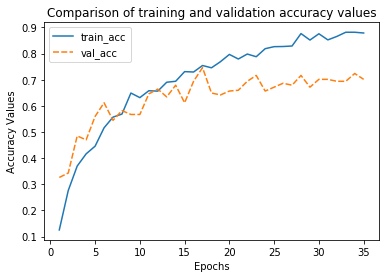

In [46]:
create_line_charts(create_acc_df(model_history_data1, 35), 'Comparison of training and validation accuracy values', 'Epochs', 'Accuracy Values')

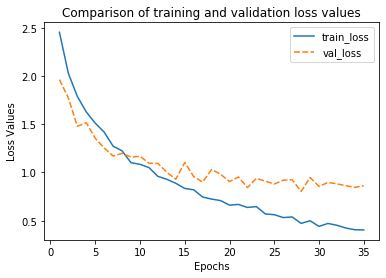

In [48]:
create_line_charts(create_loss_df(model_history_data1, 35), 'Comparison of training and validation loss values', 'Epochs', 'Loss Values')

In [49]:
test_generator1 = test_datagen1.flow_from_directory(test_dir, target_size=(256,256), batch_size=batch_size, class_mode='categorical')
test_loss1, test_accuracy1 = custom_model1.evaluate_generator(test_generator1, steps=test_steps)
print('test_loss', test_loss1)
print('test_accuracy', test_accuracy1)

Found 150 images belonging to 10 classes.
test_loss 0.8105971879429288
test_accuracy 0.7569444444444444


Now let us try fine tuning the convnet layers to see whether we can improve upon the existing results.

In [0]:
conv_base2 = get_VGG19_Conv_Base((256,256,3))

In [0]:
def print_layer_details(conv_base):
  for layer in conv_base.layers:
    print('layer name:', layer.name)
    print('layer trainable:', layer.trainable)

In [0]:
def fine_tune_conv_base_block(conv_base, block_name_start):
  trainable = False
  for layer in conv_base.layers:
    if layer.name.startswith(block_name_start):
      trainable = True
    layer.trainable = trainable

In [53]:
print_layer_details(conv_base2)

layer name: input_2
layer trainable: False
layer name: block1_conv1
layer trainable: True
layer name: block1_conv2
layer trainable: True
layer name: block1_pool
layer trainable: True
layer name: block2_conv1
layer trainable: True
layer name: block2_conv2
layer trainable: True
layer name: block2_pool
layer trainable: True
layer name: block3_conv1
layer trainable: True
layer name: block3_conv2
layer trainable: True
layer name: block3_conv3
layer trainable: True
layer name: block3_conv4
layer trainable: True
layer name: block3_pool
layer trainable: True
layer name: block4_conv1
layer trainable: True
layer name: block4_conv2
layer trainable: True
layer name: block4_conv3
layer trainable: True
layer name: block4_conv4
layer trainable: True
layer name: block4_pool
layer trainable: True
layer name: block5_conv1
layer trainable: True
layer name: block5_conv2
layer trainable: True
layer name: block5_conv3
layer trainable: True
layer name: block5_conv4
layer trainable: True
layer name: block5_po

In [0]:
fine_tune_conv_base_block(conv_base2, 'block5')

In [57]:
print_layer_details(conv_base2)

layer name: input_2
layer trainable: False
layer name: block1_conv1
layer trainable: False
layer name: block1_conv2
layer trainable: False
layer name: block1_pool
layer trainable: False
layer name: block2_conv1
layer trainable: False
layer name: block2_conv2
layer trainable: False
layer name: block2_pool
layer trainable: False
layer name: block3_conv1
layer trainable: False
layer name: block3_conv2
layer trainable: False
layer name: block3_conv3
layer trainable: False
layer name: block3_conv4
layer trainable: False
layer name: block3_pool
layer trainable: False
layer name: block4_conv1
layer trainable: False
layer name: block4_conv2
layer trainable: False
layer name: block4_conv3
layer trainable: False
layer name: block4_conv4
layer trainable: False
layer name: block4_pool
layer trainable: False
layer name: block5_conv1
layer trainable: True
layer name: block5_conv2
layer trainable: True
layer name: block5_conv3
layer trainable: True
layer name: block5_conv4
layer trainable: True
layer

In [0]:
custom_model2 = models.Sequential()
custom_model2.add(conv_base2)
custom_model2.add(layers.Flatten())
custom_model2.add(layers.Dropout(rate=0.3))
custom_model2.add(layers.Dense(512, activation='relu'))
custom_model2.add(layers.Dropout(rate=0.4))
custom_model2.add(layers.Dense(10, activation='softmax'))

In [59]:
custom_model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 8, 8, 512)         20024384  
_________________________________________________________________
flatten_2 (Flatten)          (None, 32768)             0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 32768)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 512)               16777728  
_________________________________________________________________
dropout_4 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 10)                5130      
Total params: 36,807,242
Trainable params: 26,222,090
Non-trainable params: 10,585,152
_________________________________

In [60]:
print('number of trainable weights', len(custom_model2.trainable_weights))

number of trainable weights 12


In [61]:
train_datagen2 = get_train_datagen()
validation_datagen2 = get_val_datagen()
test_datagen2 = get_test_datagen()

train_generator2 = train_datagen2.flow_from_directory(train_dir, target_size=(256,256), batch_size=batch_size, class_mode='categorical')
validation_generator2 = validation_datagen2.flow_from_directory(val_dir, target_size=(256,256), batch_size=batch_size, class_mode='categorical')

Found 700 images belonging to 10 classes.
Found 150 images belonging to 10 classes.


In [0]:
custom_model2.compile(loss='categorical_crossentropy', optimizer=optimizers.Adam(lr=2e-5), metrics=['accuracy'])

In [63]:
model_history_data2 = handle_model_fit_gen(custom_model2, 35, train_generator2, validation_generator2)

Epoch 1/35
43/43 [==============================] - 6s 133ms/step - loss: 2.3570 - acc: 0.1797 - val_loss: 1.6794 - val_acc: 0.4444
Epoch 2/35
43/43 [==============================] - 5s 112ms/step - loss: 1.4931 - acc: 0.4632 - val_loss: 1.1935 - val_acc: 0.5299
Epoch 3/35
43/43 [==============================] - 5s 109ms/step - loss: 1.1896 - acc: 0.5732 - val_loss: 1.0305 - val_acc: 0.6269
Epoch 4/35
43/43 [==============================] - 5s 109ms/step - loss: 0.8701 - acc: 0.6914 - val_loss: 1.0475 - val_acc: 0.6493
Epoch 5/35
43/43 [==============================] - 5s 105ms/step - loss: 0.7111 - acc: 0.7291 - val_loss: 0.8204 - val_acc: 0.7164
Epoch 6/35
43/43 [==============================] - 5s 108ms/step - loss: 0.4913 - acc: 0.8425 - val_loss: 0.9097 - val_acc: 0.6940
Epoch 7/35
43/43 [==============================] - 5s 105ms/step - loss: 0.4728 - acc: 0.8401 - val_loss: 1.0129 - val_acc: 0.6940
Epoch 8/35
43/43 [==============================] - 5s 107ms/step - loss: 0.

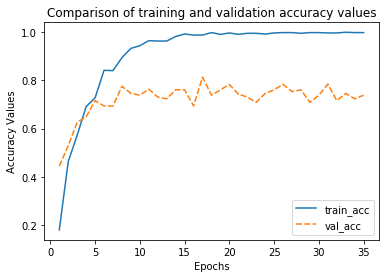

In [64]:
create_line_charts(create_acc_df(model_history_data2, 35), 'Comparison of training and validation accuracy values', 'Epochs', 'Accuracy Values')

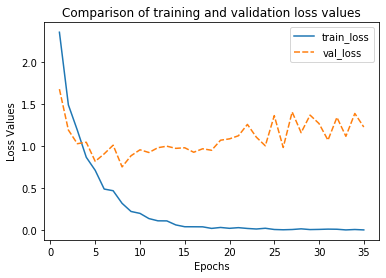

In [65]:
create_line_charts(create_loss_df(model_history_data2, 35), 'Comparison of training and validation loss values', 'Epochs', 'Loss Values')

In [66]:
test_generator2 = test_datagen2.flow_from_directory(test_dir, target_size=(256,256), batch_size=batch_size, class_mode='categorical')
test_loss2, test_accuracy2 = custom_model2.evaluate_generator(test_generator2, steps=test_steps)
print('test_loss', test_loss2)
print('test_accuracy', test_accuracy2)

Found 150 images belonging to 10 classes.
test_loss 1.0097176962428622
test_accuracy 0.7847222222222222


As we can see from the above results we were able to increase the accuracy after fine tuning